In [1]:
# installing libraries

In [2]:
# !pip install ploty

In [3]:
# !pip install countryinfo

In [4]:
#import packages
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

# Exploring the dataset

In [5]:
df = pd.read_csv ('data/GSAF5.csv')

In [6]:
display(df)

,Case Number,Date,Year,Type,Country,Area,Location,Activity,Name,Sex,...,Species,Investigator or Source,pdf,href formula,href,Case Number.1,Case Number.2,original order,Unnamed: 22,Unnamed: 23
0,2016.09.18.c,18-Sep-16,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,...,NaN,"Orlando Sentinel, 9/19/2016",2016.09.18.c-NSB.pdf,http://sharkattackfile.net/spreadsheets/pdf_di...,http://sharkattackfile.net/spreadsheets/pdf_di...,2016.09.18.c,2016.09.18.c,5993,NaN,NaN
1,2016.09.18.b,18-Sep-16,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,Chucky Luciano,M,...,NaN,"Orlando Sentinel, 9/19/2016",2016.09.18.b-Luciano.pdf,http://sharkattackfile.net/spreadsheets/pdf_di...,http://sharkattackfile.net/spreadsheets/pdf_di...,2016.09.18.b,2016.09.18.b,5992,NaN,NaN
2,2016.09.18.a,18-Sep-16,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,...,NaN,"Orlando Sentinel, 9/19/2016",2016.09.18.a-NSB.pdf,http://sharkattackfile.net/spreadsheets/pdf_di...,http://sharkattackfile.net/spreadsheets/pdf_di...,2016.09.18.a,2016.09.18.a,5991,NaN,NaN
3,2016.09.17,17-Sep-16,2016,Unprovoked,AUSTRALIA,Victoria,Thirteenth Beach,Surfing,Rory Angiolella,M,...,NaN,"The Age, 9/18/2016",2016.09.17-Angiolella.pdf,http://sharkattackfile.net/spreadsheets/pdf_di...,http://sharkattackfile.net/spreadsheets/pdf_di...,2016.09.17,2016.09.17,5990,NaN,NaN
4,2016.09.15,16-Sep-16,2016,Unprovoked,AUSTRALIA,Victoria,Bells Beach,Surfing,male,M,...,2 m shark,"The Age, 9/16/2016",2016.09.16-BellsBeach.pdf,http://sharkattackfile.net/spreadsheets/pdf_di...,http://sharkattackfile.net/spreadsheets/pdf_di...,2016.09.16,2016.09.15,5989,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5987,ND.0005,Before 1903,0,Unprovoked,AUSTRALIA,Western Australia,Roebuck Bay,Diving,male,M,...,NaN,"H. Taunton; N. Bartlett, p. 234",ND-0005-RoebuckBay.pdf,http://sharkattackfile.net/spreadsheets/pdf_di...,http://sharkattackfile.net/spreadsheets/pdf_di...,ND.0005,ND.0005,6,NaN,NaN
5988,ND.0004,Before 1903,0,Unprovoked,AUSTRALIA,Western Australia,NaN,Pearl diving,Ahmun,M,...,NaN,"H. Taunton; N. Bartlett, pp. 233-234",ND-0004-Ahmun.pdf,http://sharkattackfile.net/spreadsheets/pdf_di...,http://sharkattackfile.net/spreadsheets/pdf_di...,ND.0004,ND.0004,5,NaN,NaN
5989,ND.0003,1900-1905,0,Unprovoked,USA,North Carolina,Ocracoke Inlet,Swimming,Coast Guard personnel,M,...,NaN,"F. Schwartz, p.23; C. Creswell, GSAF",ND-0003-Ocracoke_1900-1905.pdf,http://sharkattackfile.net/spreadsheets/pdf_di...,http://sharkattackfile.net/spreadsheets/pdf_di...,ND.0003,ND.0003,4,NaN,NaN
5990,ND.0002,1883-1889,0,Unprovoked,PANAMA,NaN,"Panama Bay 8�N, 79�W",NaN,Jules Patterson,M,...,NaN,"The Sun, 10/20/1938",ND-0002-JulesPatterson.pdf,http://sharkattackfile.net/spreadsheets/pdf_di...,http://sharkattackfile.net/spreadsheets/pdf_di...,ND.0002,ND.0002,3,NaN,NaN


In [7]:
# making a security copy
df_copy = df.copy()

In [8]:
# to know the names of the columns
df.columns

Index(['Case Number', 'Date', 'Year', 'Type', 'Country', 'Area', 'Location',
       'Activity', 'Name', 'Sex ', 'Age', 'Injury', 'Fatal (Y/N)', 'Time',
       'Species ', 'Investigator or Source', 'pdf', 'href formula', 'href',
       'Case Number.1', 'Case Number.2', 'original order', 'Unnamed: 22',
       'Unnamed: 23'],
      dtype='object')

In [9]:
# to know how many N/As I have in each column
df.isna().sum()

Case Number                  0
Date                         0
Year                         0
Type                         0
Country                     43
Area                       402
Location                   496
Activity                   527
Name                       200
Sex                        567
Age                       2681
Injury                      27
Fatal (Y/N)                 19
Time                      3213
Species                   2934
Investigator or Source      15
pdf                          0
href formula                 1
href                         3
Case Number.1                0
Case Number.2                0
original order               0
Unnamed: 22               5991
Unnamed: 23               5990
dtype: int64

In [10]:
# I will remove the columns with over 50% of N/As rows and the ones that I don't think are relevant
df = df.drop(['Unnamed: 22', 'Unnamed: 23', 'Time', 'href formula', 'href', 'Case Number.1', 'Case Number.2', 'original order','Case Number', 'pdf'], axis = 1)

In [11]:
# Checking how it looks like now
pd.set_option("display.max_columns", 24) 
df

,Date,Year,Type,Country,Area,Location,Activity,Name,Sex,Age,Injury,Fatal (Y/N),Species,Investigator or Source
0,18-Sep-16,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,16,Minor injury to thigh,N,NaN,"Orlando Sentinel, 9/19/2016"
1,18-Sep-16,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,Chucky Luciano,M,36,Lacerations to hands,N,NaN,"Orlando Sentinel, 9/19/2016"
2,18-Sep-16,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,43,Lacerations to lower leg,N,NaN,"Orlando Sentinel, 9/19/2016"
3,17-Sep-16,2016,Unprovoked,AUSTRALIA,Victoria,Thirteenth Beach,Surfing,Rory Angiolella,M,NaN,Struck by fin on chest & leg,N,NaN,"The Age, 9/18/2016"
4,16-Sep-16,2016,Unprovoked,AUSTRALIA,Victoria,Bells Beach,Surfing,male,M,NaN,No injury: Knocked off board by shark,N,2 m shark,"The Age, 9/16/2016"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5987,Before 1903,0,Unprovoked,AUSTRALIA,Western Australia,Roebuck Bay,Diving,male,M,NaN,FATAL,Y,NaN,"H. Taunton; N. Bartlett, p. 234"
5988,Before 1903,0,Unprovoked,AUSTRALIA,Western Australia,NaN,Pearl diving,Ahmun,M,NaN,FATAL,Y,NaN,"H. Taunton; N. Bartlett, pp. 233-234"
5989,1900-1905,0,Unprovoked,USA,North Carolina,Ocracoke Inlet,Swimming,Coast Guard personnel,M,NaN,FATAL,Y,NaN,"F. Schwartz, p.23; C. Creswell, GSAF"
5990,1883-1889,0,Unprovoked,PANAMA,NaN,"Panama Bay 8�N, 79�W",NaN,Jules Patterson,M,NaN,FATAL,Y,NaN,"The Sun, 10/20/1938"


In [12]:
df.isna().sum()

Date                         0
Year                         0
Type                         0
Country                     43
Area                       402
Location                   496
Activity                   527
Name                       200
Sex                        567
Age                       2681
Injury                      27
Fatal (Y/N)                 19
Species                   2934
Investigator or Source      15
dtype: int64

In [13]:
# I still have many N/As, but I believe the columns Age and Species could be useful for the analysis, I dont't want to discard them, so I'm going to drop the rows with only NaN values
df.dropna(how = "all", inplace = True)

In [14]:
df.shape
# casi nada ha cambiado

(5992, 14)

In [15]:
# Dropping duplicated results:
df.drop_duplicates(inplace=True)
df.drop

<bound method DataFrame.drop of              Date  Year        Type             Country               Area  \
0       18-Sep-16  2016  Unprovoked                 USA            Florida   
1       18-Sep-16  2016  Unprovoked                 USA            Florida   
2       18-Sep-16  2016  Unprovoked                 USA            Florida   
3       17-Sep-16  2016  Unprovoked           AUSTRALIA           Victoria   
4       16-Sep-16  2016  Unprovoked           AUSTRALIA           Victoria   
...           ...   ...         ...                 ...                ...   
5987  Before 1903     0  Unprovoked           AUSTRALIA  Western Australia   
5988  Before 1903     0  Unprovoked           AUSTRALIA  Western Australia   
5989    1900-1905     0  Unprovoked                 USA     North Carolina   
5990    1883-1889     0  Unprovoked              PANAMA                NaN   
5991    1845-1853     0  Unprovoked  CEYLON (SRI LANKA)   Eastern Province   

                               

In [16]:
# Filling all NaN with 0s
df = df.fillna(0)
df

,Date,Year,Type,Country,Area,Location,Activity,Name,Sex,Age,Injury,Fatal (Y/N),Species,Investigator or Source
0,18-Sep-16,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,16,Minor injury to thigh,N,0,"Orlando Sentinel, 9/19/2016"
1,18-Sep-16,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,Chucky Luciano,M,36,Lacerations to hands,N,0,"Orlando Sentinel, 9/19/2016"
2,18-Sep-16,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,43,Lacerations to lower leg,N,0,"Orlando Sentinel, 9/19/2016"
3,17-Sep-16,2016,Unprovoked,AUSTRALIA,Victoria,Thirteenth Beach,Surfing,Rory Angiolella,M,0,Struck by fin on chest & leg,N,0,"The Age, 9/18/2016"
4,16-Sep-16,2016,Unprovoked,AUSTRALIA,Victoria,Bells Beach,Surfing,male,M,0,No injury: Knocked off board by shark,N,2 m shark,"The Age, 9/16/2016"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5987,Before 1903,0,Unprovoked,AUSTRALIA,Western Australia,Roebuck Bay,Diving,male,M,0,FATAL,Y,0,"H. Taunton; N. Bartlett, p. 234"
5988,Before 1903,0,Unprovoked,AUSTRALIA,Western Australia,0,Pearl diving,Ahmun,M,0,FATAL,Y,0,"H. Taunton; N. Bartlett, pp. 233-234"
5989,1900-1905,0,Unprovoked,USA,North Carolina,Ocracoke Inlet,Swimming,Coast Guard personnel,M,0,FATAL,Y,0,"F. Schwartz, p.23; C. Creswell, GSAF"
5990,1883-1889,0,Unprovoked,PANAMA,0,"Panama Bay 8�N, 79�W",0,Jules Patterson,M,0,FATAL,Y,0,"The Sun, 10/20/1938"


In [17]:
# Checking if it worked
df.isna().sum()

Date                      0
Year                      0
Type                      0
Country                   0
Area                      0
Location                  0
Activity                  0
Name                      0
Sex                       0
Age                       0
Injury                    0
Fatal (Y/N)               0
Species                   0
Investigator or Source    0
dtype: int64

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5991 entries, 0 to 5991
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   Date                    5991 non-null   object
 1   Year                    5991 non-null   int64 
 2   Type                    5991 non-null   object
 3   Country                 5991 non-null   object
 4   Area                    5991 non-null   object
 5   Location                5991 non-null   object
 6   Activity                5991 non-null   object
 7   Name                    5991 non-null   object
 8   Sex                     5991 non-null   object
 9   Age                     5991 non-null   object
 10  Injury                  5991 non-null   object
 11  Fatal (Y/N)             5991 non-null   object
 12  Species                 5991 non-null   object
 13  Investigator or Source  5991 non-null   object
dtypes: int64(1), object(13)
memory usage: 702.1+ KB


In [19]:
df.describe()

,Year
count,5991.000000
mean,1925.201636
std,286.497531
min,0.000000
25%,1942.000000
50%,1975.000000
75%,2003.000000
max,2016.000000


# Working with Date and Year columns

In [20]:
set (df['Date'])

{'Ca. 1903',
 '01-Jul-81',
 '14-Sep-08',
 '03-Feb-85',
 '19-Apr-16',
 'Summer-2008',
 '28-Dec-12',
 '09-Dec-64',
 '03-Sep-89',
 '1895',
 'Reported 23-Sep-1901',
 '14-Jan-29',
 '06-Sep-14',
 '17-May-09',
 '05-Jun-98',
 '19-Jul-85',
 ' 19-Aug-1993',
 '15-Mar-08',
 '09-Mar-37',
 '13-May-49',
 '10-Apr-60',
 'Reported 09-Apr-1909',
 '01-Jul-15',
 '26-Sep-93',
 '30-Oct-12',
 '13-Aug-09',
 '07-Feb-09',
 '07-Aug-1852',
 '17-Jan-98',
 'Reported 21-Mar-2013',
 'Reported 24-Jan-1920',
 '04-Jan-42',
 '26-May-97',
 '19-Dec-65',
 '18-Sep-53',
 '20-Jan-44',
 '22-Mar-07',
 '12-Oct-91',
 '10-Oct-88',
 '18-May-16',
 '14-Nov-01',
 'Sep-98',
 '04-Sep-36',
 '29-Sep-51',
 '16-Jun-13',
 '01-Apr-72',
 'Early Jun-2000',
 '04-Sep-54',
 '17-Sep-16',
 '10-Aug-59',
 '22-Nov-1889',
 '12-Feb-11',
 '18-Sep-16',
 '13-Sep-67',
 '27-May-88',
 '18-Jun-35',
 '09-Oct-94',
 'Reported 18-Jun-1888',
 '1989',
 '10-Dec-08',
 '1839/1840',
 '20-Nov-14',
 '21-Jan-1883',
 '10-May-81',
 '26-Aug-99',
 'Reported 09-Jan-1970',
 '02-Feb

In [21]:
set (df['Year'])

{0,
 5,
 77,
 500,
 1543,
 1554,
 1555,
 1580,
 1595,
 1617,
 1637,
 1638,
 1642,
 1700,
 1703,
 1721,
 1733,
 1738,
 1742,
 1748,
 1749,
 1755,
 1758,
 1764,
 1767,
 1771,
 1776,
 1779,
 1785,
 1787,
 1788,
 1791,
 1800,
 1803,
 1804,
 1805,
 1807,
 1811,
 1812,
 1816,
 1817,
 1818,
 1819,
 1822,
 1825,
 1826,
 1827,
 1828,
 1829,
 1830,
 1831,
 1832,
 1834,
 1835,
 1836,
 1837,
 1839,
 1840,
 1841,
 1842,
 1844,
 1845,
 1846,
 1847,
 1848,
 1849,
 1850,
 1851,
 1852,
 1853,
 1854,
 1855,
 1856,
 1858,
 1859,
 1860,
 1861,
 1862,
 1863,
 1864,
 1865,
 1866,
 1867,
 1868,
 1869,
 1870,
 1871,
 1872,
 1873,
 1874,
 1875,
 1876,
 1877,
 1878,
 1879,
 1880,
 1881,
 1882,
 1883,
 1884,
 1885,
 1886,
 1887,
 1888,
 1889,
 1890,
 1891,
 1892,
 1893,
 1894,
 1895,
 1896,
 1897,
 1898,
 1899,
 1900,
 1901,
 1902,
 1903,
 1904,
 1905,
 1906,
 1907,
 1908,
 1909,
 1910,
 1911,
 1912,
 1913,
 1914,
 1915,
 1916,
 1917,
 1918,
 1919,
 1920,
 1921,
 1922,
 1923,
 1924,
 1925,
 1926,
 1927,
 1928,
 

In [22]:
# I am not using Date as it brings the same information than in year
df = df.drop(['Date'], axis = 1)
df

,Year,Type,Country,Area,Location,Activity,Name,Sex,Age,Injury,Fatal (Y/N),Species,Investigator or Source
0,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,16,Minor injury to thigh,N,0,"Orlando Sentinel, 9/19/2016"
1,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,Chucky Luciano,M,36,Lacerations to hands,N,0,"Orlando Sentinel, 9/19/2016"
2,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,43,Lacerations to lower leg,N,0,"Orlando Sentinel, 9/19/2016"
3,2016,Unprovoked,AUSTRALIA,Victoria,Thirteenth Beach,Surfing,Rory Angiolella,M,0,Struck by fin on chest & leg,N,0,"The Age, 9/18/2016"
4,2016,Unprovoked,AUSTRALIA,Victoria,Bells Beach,Surfing,male,M,0,No injury: Knocked off board by shark,N,2 m shark,"The Age, 9/16/2016"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5987,0,Unprovoked,AUSTRALIA,Western Australia,Roebuck Bay,Diving,male,M,0,FATAL,Y,0,"H. Taunton; N. Bartlett, p. 234"
5988,0,Unprovoked,AUSTRALIA,Western Australia,0,Pearl diving,Ahmun,M,0,FATAL,Y,0,"H. Taunton; N. Bartlett, pp. 233-234"
5989,0,Unprovoked,USA,North Carolina,Ocracoke Inlet,Swimming,Coast Guard personnel,M,0,FATAL,Y,0,"F. Schwartz, p.23; C. Creswell, GSAF"
5990,0,Unprovoked,PANAMA,0,"Panama Bay 8�N, 79�W",0,Jules Patterson,M,0,FATAL,Y,0,"The Sun, 10/20/1938"


In [23]:
# Sorting year in descending order
df.sort_values ('Year', ascending = False, inplace = True)
df

,Year,Type,Country,Area,Location,Activity,Name,Sex,Age,Injury,Fatal (Y/N),Species,Investigator or Source
0,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,16,Minor injury to thigh,N,0,"Orlando Sentinel, 9/19/2016"
52,2016,Unprovoked,AUSTRALIA,Western Australia,Mindarie,Diving,Doreen Collyer,F,60,FATAL,Y,3+ m shark,"B. Myatt, GSAF"
76,2016,Unprovoked,USA,Hawaii,"Olowalu, Maui",Snorkeling,J. Orr,F,46,Minor injury to left foot,N,0,"Maui Now, 3/31/2016"
75,2016,Invalid,USA,Florida,"Corners Beach, Jupiter, Palm Beach County",SUP,Maximo Trinidad,M,0,Fell off board when spinner shark leapt from t...,N,0,YouTube
74,2016,Unprovoked,USA,Florida,"Florida Keys, Monroe County",Fishing,Jonathan Lester,M,34,Left hand bitten,N,5' to 6' shark,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5904,0,Unprovoked,AUSTRALIA,Torres Strait,0,Helmet diving,male,M,0,"No injury, helmet bitten",N,Tiger shark,"A. Seekee & R. Callinan, Courier-Mail, 7/7/199..."
5903,0,Unprovoked,SOUTH AFRICA,Western Cape Province,"Murray Bay, Robben Island",Swimming,"male, a mental patient",M,0,"FATAL, body not recovered",Y,0,"L.Green, A Decent Fellow doesn't Work, p.225"
5902,0,Boat,MOZAMBIQUE,Inhambane Province,Off Inhambane,Fishing,"4.8-metre skiboat, Occupants: Rod Salm & 4 fri...",0,0,"No injury to occupants, shark bumped boat",N,Whale shark,South African Shark Attack File
5901,0,Unprovoked,GREECE,Dodecanese Islands,Near Symi Island,Free diving for sponges,male,M,0,FATAL,Y,0,M. Kalafatas


In [24]:
# Checking how many of each year I have
df["Year"].value_counts()

2015    139
2011    128
2014    125
0       124
2013    122
       ... 
1854      1
1850      1
1846      1
1834      1
1554      1
Name: Year, Length: 232, dtype: int64

In [25]:
# reseting the index
df.reset_index(drop=True,inplace = True)
df

,Year,Type,Country,Area,Location,Activity,Name,Sex,Age,Injury,Fatal (Y/N),Species,Investigator or Source
0,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,16,Minor injury to thigh,N,0,"Orlando Sentinel, 9/19/2016"
1,2016,Unprovoked,AUSTRALIA,Western Australia,Mindarie,Diving,Doreen Collyer,F,60,FATAL,Y,3+ m shark,"B. Myatt, GSAF"
2,2016,Unprovoked,USA,Hawaii,"Olowalu, Maui",Snorkeling,J. Orr,F,46,Minor injury to left foot,N,0,"Maui Now, 3/31/2016"
3,2016,Invalid,USA,Florida,"Corners Beach, Jupiter, Palm Beach County",SUP,Maximo Trinidad,M,0,Fell off board when spinner shark leapt from t...,N,0,YouTube
4,2016,Unprovoked,USA,Florida,"Florida Keys, Monroe County",Fishing,Jonathan Lester,M,34,Left hand bitten,N,5' to 6' shark,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5986,0,Unprovoked,AUSTRALIA,Torres Strait,0,Helmet diving,male,M,0,"No injury, helmet bitten",N,Tiger shark,"A. Seekee & R. Callinan, Courier-Mail, 7/7/199..."
5987,0,Unprovoked,SOUTH AFRICA,Western Cape Province,"Murray Bay, Robben Island",Swimming,"male, a mental patient",M,0,"FATAL, body not recovered",Y,0,"L.Green, A Decent Fellow doesn't Work, p.225"
5988,0,Boat,MOZAMBIQUE,Inhambane Province,Off Inhambane,Fishing,"4.8-metre skiboat, Occupants: Rod Salm & 4 fri...",0,0,"No injury to occupants, shark bumped boat",N,Whale shark,South African Shark Attack File
5989,0,Unprovoked,GREECE,Dodecanese Islands,Near Symi Island,Free diving for sponges,male,M,0,FATAL,Y,0,M. Kalafatas


In [26]:
# I want to identify which row is the year 1900
pd.set_option("display.max_rows",None) 
df

,Year,Type,Country,Area,Location,Activity,Name,Sex,Age,Injury,Fatal (Y/N),Species,Investigator or Source
0,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,16,Minor injury to thigh,N,0,"Orlando Sentinel, 9/19/2016"
1,2016,Unprovoked,AUSTRALIA,Western Australia,Mindarie,Diving,Doreen Collyer,F,60,FATAL,Y,3+ m shark,"B. Myatt, GSAF"
2,2016,Unprovoked,USA,Hawaii,"Olowalu, Maui",Snorkeling,J. Orr,F,46,Minor injury to left foot,N,0,"Maui Now, 3/31/2016"
3,2016,Invalid,USA,Florida,"Corners Beach, Jupiter, Palm Beach County",SUP,Maximo Trinidad,M,0,Fell off board when spinner shark leapt from t...,N,0,YouTube
4,2016,Unprovoked,USA,Florida,"Florida Keys, Monroe County",Fishing,Jonathan Lester,M,34,Left hand bitten,N,5' to 6' shark,0
5,2016,Invalid,CAPE VERDE,Boa Vista Island,0,0,a British citizen,M,60,"""Serious""",N,Shark involvement not confirmed,L.O.Guttke
6,2016,Unprovoked,NEW CALEDONIA,Grand Terre,Poe Beach,Walking,Nicole Malignon,F,69,FATAL,Y,"Tiger shark, 2.5 m",Les Nouvelles Caledonnie. 4/11/2016
7,2016,Unprovoked,USA,Florida,"Off Singer Island, Palm Beach County",Spearfishing,Kyle Senkowicz,M,26,Multiple bites to right arm,N,"Bull shark, 7'","Palm Beach Post, 4/13/2016"
8,2016,Provoked,FRENCH POLYNESIA,Tuamotos,Makemo Atoll,Spearfishing,Teva Tokoragi,M,26,"Severe lacerations to right forearm, hand and ...",N,"Grey reef shark, 2 m","Tahiti Infos, 4/19/2016"
9,2016,Unprovoked,AUSTRALIA,New South Wales,"First Sun Beach, Byron Bay",Swimming,Zak Kedem,M,12,Minor puncture wound to foot,N,Wobbegong shark,"Gold Coast Bulletin, 4/19/2016"


In [27]:
# Filling NAs
df['Year'].fillna("0",inplace = True)

In [28]:
# dropping rows of year below 1900, because it's not relevant for the analysis
df.drop(df.index[5323:5991], inplace = True)
df

,Year,Type,Country,Area,Location,Activity,Name,Sex,Age,Injury,Fatal (Y/N),Species,Investigator or Source
0,2016,Unprovoked,USA,Florida,"New Smyrna Beach, Volusia County",Surfing,male,M,16,Minor injury to thigh,N,0,"Orlando Sentinel, 9/19/2016"
1,2016,Unprovoked,AUSTRALIA,Western Australia,Mindarie,Diving,Doreen Collyer,F,60,FATAL,Y,3+ m shark,"B. Myatt, GSAF"
2,2016,Unprovoked,USA,Hawaii,"Olowalu, Maui",Snorkeling,J. Orr,F,46,Minor injury to left foot,N,0,"Maui Now, 3/31/2016"
3,2016,Invalid,USA,Florida,"Corners Beach, Jupiter, Palm Beach County",SUP,Maximo Trinidad,M,0,Fell off board when spinner shark leapt from t...,N,0,YouTube
4,2016,Unprovoked,USA,Florida,"Florida Keys, Monroe County",Fishing,Jonathan Lester,M,34,Left hand bitten,N,5' to 6' shark,0
5,2016,Invalid,CAPE VERDE,Boa Vista Island,0,0,a British citizen,M,60,"""Serious""",N,Shark involvement not confirmed,L.O.Guttke
6,2016,Unprovoked,NEW CALEDONIA,Grand Terre,Poe Beach,Walking,Nicole Malignon,F,69,FATAL,Y,"Tiger shark, 2.5 m",Les Nouvelles Caledonnie. 4/11/2016
7,2016,Unprovoked,USA,Florida,"Off Singer Island, Palm Beach County",Spearfishing,Kyle Senkowicz,M,26,Multiple bites to right arm,N,"Bull shark, 7'","Palm Beach Post, 4/13/2016"
8,2016,Provoked,FRENCH POLYNESIA,Tuamotos,Makemo Atoll,Spearfishing,Teva Tokoragi,M,26,"Severe lacerations to right forearm, hand and ...",N,"Grey reef shark, 2 m","Tahiti Infos, 4/19/2016"
9,2016,Unprovoked,AUSTRALIA,New South Wales,"First Sun Beach, Byron Bay",Swimming,Zak Kedem,M,12,Minor puncture wound to foot,N,Wobbegong shark,"Gold Coast Bulletin, 4/19/2016"


In [29]:
# Checking how many of each Year I have now
df["Year"].value_counts()

2015    139
2011    128
2014    125
2013    122
2008    121
2009    120
2012    117
2007    112
2016    103
2006    103
2005    103
2010    101
2000     97
1959     93
1960     93
2003     92
2001     92
2004     92
2002     88
1962     86
1961     78
1995     76
1964     66
1998     65
1999     65
1996     61
1963     61
1966     58
1997     57
1992     56
1993     56
1994     56
1988     55
1958     54
1989     53
1956     51
1965     51
1983     50
1981     49
1975     49
1967     48
1968     46
1950     43
1955     43
1954     42
1970     42
1984     41
1942     41
1957     41
1982     40
1986     39
1976     39
1990     38
1991     38
1974     38
1985     37
1929     37
1953     36
1980     35
1972     35
1987     35
1935     32
1949     31
1944     31
1951     31
1937     30
1947     30
1969     30
1936     30
1952     29
1948     29
1931     29
1971     28
1943     27
1973     27
1941     27
1934     27
1932     27
1977     26
1928     26
1946     26
1930     26
1979     25
1978

In [30]:
# Creating year ranges
pd.cut(df['Year'], [1900,1950,1975,1985,1995,2005,2016])

0       (2005.0, 2016.0]
1       (2005.0, 2016.0]
2       (2005.0, 2016.0]
3       (2005.0, 2016.0]
4       (2005.0, 2016.0]
5       (2005.0, 2016.0]
6       (2005.0, 2016.0]
7       (2005.0, 2016.0]
8       (2005.0, 2016.0]
9       (2005.0, 2016.0]
10      (2005.0, 2016.0]
11      (2005.0, 2016.0]
12      (2005.0, 2016.0]
13      (2005.0, 2016.0]
14      (2005.0, 2016.0]
15      (2005.0, 2016.0]
16      (2005.0, 2016.0]
17      (2005.0, 2016.0]
18      (2005.0, 2016.0]
19      (2005.0, 2016.0]
20      (2005.0, 2016.0]
21      (2005.0, 2016.0]
22      (2005.0, 2016.0]
23      (2005.0, 2016.0]
24      (2005.0, 2016.0]
25      (2005.0, 2016.0]
26      (2005.0, 2016.0]
27      (2005.0, 2016.0]
28      (2005.0, 2016.0]
29      (2005.0, 2016.0]
30      (2005.0, 2016.0]
31      (2005.0, 2016.0]
32      (2005.0, 2016.0]
33      (2005.0, 2016.0]
34      (2005.0, 2016.0]
35      (2005.0, 2016.0]
36      (2005.0, 2016.0]
37      (2005.0, 2016.0]
38      (2005.0, 2016.0]
39      (2005.0, 2016.0]


In [31]:
# Creating year lablels
pd.cut(df['Year'], [1900,1950,1975,1985,1995,2005,2016], labels=['1900<>1950', '1950<>1975', '1975<>1985', '1985<>1995','1995<>2005','2005<>2016'])

0       2005<>2016
1       2005<>2016
2       2005<>2016
3       2005<>2016
4       2005<>2016
5       2005<>2016
6       2005<>2016
7       2005<>2016
8       2005<>2016
9       2005<>2016
10      2005<>2016
11      2005<>2016
12      2005<>2016
13      2005<>2016
14      2005<>2016
15      2005<>2016
16      2005<>2016
17      2005<>2016
18      2005<>2016
19      2005<>2016
20      2005<>2016
21      2005<>2016
22      2005<>2016
23      2005<>2016
24      2005<>2016
25      2005<>2016
26      2005<>2016
27      2005<>2016
28      2005<>2016
29      2005<>2016
30      2005<>2016
31      2005<>2016
32      2005<>2016
33      2005<>2016
34      2005<>2016
35      2005<>2016
36      2005<>2016
37      2005<>2016
38      2005<>2016
39      2005<>2016
40      2005<>2016
41      2005<>2016
42      2005<>2016
43      2005<>2016
44      2005<>2016
45      2005<>2016
46      2005<>2016
47      2005<>2016
48      2005<>2016
49      2005<>2016
50      2005<>2016
51      2005<>2016
52      2005

In [32]:
pd.cut(df['Year'], [1900,1950,1975,1985,1995,2005,2016], labels=['1900<>1950', '1950<>1975', '1975<>1985', '1985<>1995','1995<>2005','2005<>2016']).value_counts()

2005<>2016    1291
1950<>1975    1256
1900<>1950    1082
1995<>2005     812
1985<>1995     502
1975<>1985     367
Name: Year, dtype: int64

<AxesSubplot:>

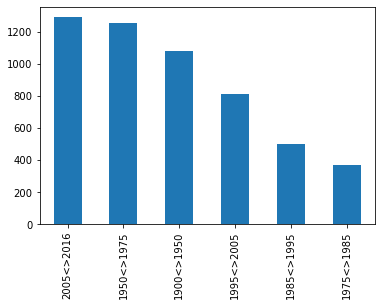

In [33]:
# Bar graph showing the increase in number of cases reported since 1900 to 2016
pd.cut(df['Year'], [1900,1950,1975,1985,1995,2005,2016], labels=['1900<>1950', '1950<>1975', '1975<>1985', '1985<>1995','1995<>2005','2005<>2016']).value_counts().plot(kind = "bar")

# Countries

In [34]:
# Checking how many of each country I have
df["Country"].value_counts()

USA                               1991
AUSTRALIA                         1124
SOUTH AFRICA                       535
PAPUA NEW GUINEA                   129
BRAZIL                             100
NEW ZEALAND                         94
BAHAMAS                             90
MEXICO                              73
ITALY                               61
PHILIPPINES                         55
REUNION                             55
FIJI                                50
NEW CALEDONIA                       49
MOZAMBIQUE                          41
EGYPT                               30
SPAIN                               29
JAPAN                               29
CUBA                                28
CROATIA                             27
PANAMA                              27
SOLOMON ISLANDS                     25
IRAN                                25
HONG KONG                           24
0                                   22
FRENCH POLYNESIA                    19
JAMAICA                  

In [35]:
df['Country'].fillna("Unknown",inplace = True)

In [36]:
# I am not using Area and Location as it brings basically the same information than in Country
df = df.drop(['Area','Location'], axis = 1)
df

,Year,Type,Country,Activity,Name,Sex,Age,Injury,Fatal (Y/N),Species,Investigator or Source
0,2016,Unprovoked,USA,Surfing,male,M,16,Minor injury to thigh,N,0,"Orlando Sentinel, 9/19/2016"
1,2016,Unprovoked,AUSTRALIA,Diving,Doreen Collyer,F,60,FATAL,Y,3+ m shark,"B. Myatt, GSAF"
2,2016,Unprovoked,USA,Snorkeling,J. Orr,F,46,Minor injury to left foot,N,0,"Maui Now, 3/31/2016"
3,2016,Invalid,USA,SUP,Maximo Trinidad,M,0,Fell off board when spinner shark leapt from t...,N,0,YouTube
4,2016,Unprovoked,USA,Fishing,Jonathan Lester,M,34,Left hand bitten,N,5' to 6' shark,0
5,2016,Invalid,CAPE VERDE,0,a British citizen,M,60,"""Serious""",N,Shark involvement not confirmed,L.O.Guttke
6,2016,Unprovoked,NEW CALEDONIA,Walking,Nicole Malignon,F,69,FATAL,Y,"Tiger shark, 2.5 m",Les Nouvelles Caledonnie. 4/11/2016
7,2016,Unprovoked,USA,Spearfishing,Kyle Senkowicz,M,26,Multiple bites to right arm,N,"Bull shark, 7'","Palm Beach Post, 4/13/2016"
8,2016,Provoked,FRENCH POLYNESIA,Spearfishing,Teva Tokoragi,M,26,"Severe lacerations to right forearm, hand and ...",N,"Grey reef shark, 2 m","Tahiti Infos, 4/19/2016"
9,2016,Unprovoked,AUSTRALIA,Swimming,Zak Kedem,M,12,Minor puncture wound to foot,N,Wobbegong shark,"Gold Coast Bulletin, 4/19/2016"


In [37]:
# Creating a list with the 20 most relevant countries
relevantcountries = df['Country'].value_counts().nlargest(20).index.to_list()
relevantcountries

['USA',
 'AUSTRALIA',
 'SOUTH AFRICA',
 'PAPUA NEW GUINEA',
 'BRAZIL',
 'NEW ZEALAND',
 'BAHAMAS',
 'MEXICO',
 'ITALY',
 'PHILIPPINES',
 'REUNION',
 'FIJI',
 'NEW CALEDONIA',
 'MOZAMBIQUE',
 'EGYPT',
 'SPAIN',
 'JAPAN',
 'CUBA',
 'CROATIA',
 'PANAMA']

In [38]:
df['Country'].value_counts().nlargest(20)

USA                 1991
AUSTRALIA           1124
SOUTH AFRICA         535
PAPUA NEW GUINEA     129
BRAZIL               100
NEW ZEALAND           94
BAHAMAS               90
MEXICO                73
ITALY                 61
PHILIPPINES           55
REUNION               55
FIJI                  50
NEW CALEDONIA         49
MOZAMBIQUE            41
EGYPT                 30
SPAIN                 29
JAPAN                 29
CUBA                  28
CROATIA               27
PANAMA                27
Name: Country, dtype: int64

<AxesSubplot:>

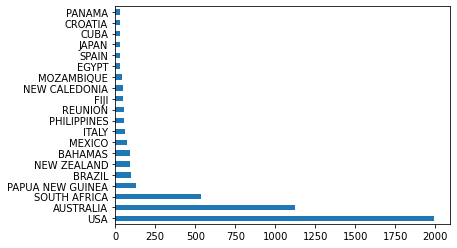

In [84]:
# We can see that the countries with the most number of incidences are USA, Australia and South Africa
df['Country'].value_counts().nlargest(20).plot(kind = "barh")

# Type

In [40]:
# I am not using Activity and Investigator or Source as I believe they're redundant with information in Type
df = df.drop(['Activity', 'Investigator or Source'], axis = 1)
df

,Year,Type,Country,Name,Sex,Age,Injury,Fatal (Y/N),Species
0,2016,Unprovoked,USA,male,M,16,Minor injury to thigh,N,0
1,2016,Unprovoked,AUSTRALIA,Doreen Collyer,F,60,FATAL,Y,3+ m shark
2,2016,Unprovoked,USA,J. Orr,F,46,Minor injury to left foot,N,0
3,2016,Invalid,USA,Maximo Trinidad,M,0,Fell off board when spinner shark leapt from t...,N,0
4,2016,Unprovoked,USA,Jonathan Lester,M,34,Left hand bitten,N,5' to 6' shark
5,2016,Invalid,CAPE VERDE,a British citizen,M,60,"""Serious""",N,Shark involvement not confirmed
6,2016,Unprovoked,NEW CALEDONIA,Nicole Malignon,F,69,FATAL,Y,"Tiger shark, 2.5 m"
7,2016,Unprovoked,USA,Kyle Senkowicz,M,26,Multiple bites to right arm,N,"Bull shark, 7'"
8,2016,Provoked,FRENCH POLYNESIA,Teva Tokoragi,M,26,"Severe lacerations to right forearm, hand and ...",N,"Grey reef shark, 2 m"
9,2016,Unprovoked,AUSTRALIA,Zak Kedem,M,12,Minor puncture wound to foot,N,Wobbegong shark


In [41]:
# Checking how many of each type I have
df["Type"].value_counts()

Unprovoked      3883
Provoked         525
Invalid          451
Boat             194
Sea Disaster     181
Boating           89
Name: Type, dtype: int64

In [42]:
# Standardizing what I believe is duplicated
df["Type"] = df["Type"].str.replace("Boating","Boat")
df["Type"].value_counts()

Unprovoked      3883
Provoked         525
Invalid          451
Boat             283
Sea Disaster     181
Name: Type, dtype: int64

In [112]:
# Crossing Type with 20 most relevant countries
types = df[['Type','Country']][df['Country'].isin(relevantcountries)]

In [120]:
# Couldn't sort the data 
# pd.crosstab(types['Country'], types['Type']).sort_values(ascending = True)
pd.crosstab(types['Country'], types['Type'])

Type,Boat,Invalid,Provoked,Sea Disaster,Unprovoked
Country,,,,,
AUSTRALIA,103,93,127,19,782
BAHAMAS,1,5,13,2,69
BRAZIL,0,8,4,3,85
CROATIA,2,3,3,0,19
CUBA,1,3,3,3,18
EGYPT,0,2,0,2,26
FIJI,1,0,2,0,47
ITALY,14,12,12,3,20
JAPAN,2,5,1,2,19


# Identities

In [45]:
# I am not using Name as it is not relevant for the analysis
df = df.drop(['Name'], axis = 1)
df

,Year,Type,Country,Sex,Age,Injury,Fatal (Y/N),Species
0,2016,Unprovoked,USA,M,16,Minor injury to thigh,N,0
1,2016,Unprovoked,AUSTRALIA,F,60,FATAL,Y,3+ m shark
2,2016,Unprovoked,USA,F,46,Minor injury to left foot,N,0
3,2016,Invalid,USA,M,0,Fell off board when spinner shark leapt from t...,N,0
4,2016,Unprovoked,USA,M,34,Left hand bitten,N,5' to 6' shark
5,2016,Invalid,CAPE VERDE,M,60,"""Serious""",N,Shark involvement not confirmed
6,2016,Unprovoked,NEW CALEDONIA,F,69,FATAL,Y,"Tiger shark, 2.5 m"
7,2016,Unprovoked,USA,M,26,Multiple bites to right arm,N,"Bull shark, 7'"
8,2016,Provoked,FRENCH POLYNESIA,M,26,"Severe lacerations to right forearm, hand and ...",N,"Grey reef shark, 2 m"
9,2016,Unprovoked,AUSTRALIA,M,12,Minor puncture wound to foot,N,Wobbegong shark


In [46]:
# Checking if Sex needs cleaning
df['Sex '].value_counts()

M      4265
F       548
0       505
M         2
lli       1
.         1
N         1
Name: Sex , dtype: int64

In [47]:
# I don't know how to clean Sex title as it has a blank space in it
df['Sex '].str.strip()

0         M
1         F
2         F
3         M
4         M
5         M
6         F
7         M
8         M
9         M
10        M
11        M
12        M
13        M
14        M
15        F
16        M
17        F
18        F
19        F
20        M
21        F
22        M
23        M
24        M
25        M
26        M
27        M
28        M
29        M
30        M
31        M
32        M
33        M
34        M
35        M
36        F
37        M
38        M
39        F
40        M
41        M
42        M
43        F
44        M
45        M
46        M
47        M
48        M
49        M
50      NaN
51        M
52        M
53        M
54        M
55        M
56        M
57        M
58        M
59        M
60        M
61        M
62        M
63        M
64        M
65        M
66        M
67        M
68        F
69        M
70        F
71        M
72      NaN
73        M
74        M
75        M
76        M
77        M
78        M
79        M
80        F
81        M
82        M
83  

In [48]:
# Filling NAs with Unknown
df['Sex '].fillna("Unknown",inplace = True)

In [49]:
# Standardizing what I believe makes sense
# At first I did it one by one but then I remembered the mapping function to do it all at once
# df["Sex "] = df["Sex "].str.replace("M","Male")
# df["Sex "] = df["Sex "].str.replace("F","Female")
# df["Sex "] = df["Sex "].str.replace("0","Unknown")

df["Sex "] = df["Sex "].map({'M':'Male', 'F': 'Female', '0':'Unknown'})
df["Sex "].value_counts()

Male      4265
Female     548
Name: Sex , dtype: int64

In [51]:
# dropping rows that are not relevant for the analysis
# I tried to do it all at once but didn't work, so I did it one by one
# df.drop(df.index[df['Sex '] == 'lli','N','.'], inplace = True)
df.drop(df.index[df['Sex '] == 'lli'], inplace = True)
df.drop(df.index[df['Sex '] == '.'], inplace = True)
df.drop(df.index[df['Sex '] == 'N'], inplace = True)
df["Sex "].value_counts()

Male      4265
Female     548
Name: Sex , dtype: int64

In [52]:
# Now checking if Age needs cleaning
df['Age'].value_counts()

0                          2102
17                          143
18                          139
20                          133
16                          132
19                          132
15                          127
21                          111
22                          109
24                          102
25                          100
14                           93
13                           84
23                           78
26                           77
27                           76
28                           75
29                           74
30                           73
12                           68
32                           64
35                           62
10                           51
31                           50
38                           47
40                           47
34                           45
43                           43
36                           40
33                           39
39                           36
37      

In [53]:
# OMG, yes. hahah
# I didn't identify anyone 100 years old

age = [str(i) for i in list(range(1, 100))]

In [54]:
# Checking if there is any NaN
df['Age'].isna().sum()

0

In [55]:
# Replacing cells that are not between 1 and 100 by an empty cell
df['Age'] = df['Age'].apply(lambda x: np.NaN if x not in age else int(x))

In [56]:
# Checking how it looks now
df['Age'].value_counts()

17.0    143
18.0    139
20.0    133
19.0    132
16.0    132
15.0    127
21.0    111
22.0    109
24.0    102
25.0    100
14.0     93
13.0     84
23.0     78
26.0     77
27.0     76
28.0     75
29.0     74
30.0     73
12.0     68
32.0     64
35.0     62
10.0     51
31.0     50
38.0     47
40.0     47
34.0     45
43.0     43
36.0     40
33.0     39
39.0     36
37.0     36
42.0     36
9.0      34
41.0     34
52.0     33
45.0     32
50.0     31
11.0     30
44.0     29
47.0     28
8.0      27
49.0     27
48.0     25
46.0     25
7.0      21
55.0     20
51.0     19
54.0     14
57.0     14
60.0     13
53.0     13
6.0      13
58.0     12
59.0     11
61.0     11
63.0      9
56.0      9
62.0      8
69.0      8
5.0       7
68.0      6
70.0      6
65.0      4
64.0      4
77.0      3
3.0       3
66.0      3
71.0      3
75.0      2
78.0      2
74.0      2
87.0      1
73.0      1
67.0      1
1.0       1
84.0      1
86.0      1
81.0      1
72.0      1
Name: Age, dtype: int64

In [57]:
# Creating age ranges
pd.cut(df['Age'], [1,10,15,25,35,65,100])

0        (15.0, 25.0]
1        (35.0, 65.0]
2        (35.0, 65.0]
3                 NaN
4        (25.0, 35.0]
5        (35.0, 65.0]
6       (65.0, 100.0]
7        (25.0, 35.0]
8        (25.0, 35.0]
9        (10.0, 15.0]
10                NaN
11       (10.0, 15.0]
12       (15.0, 25.0]
13       (35.0, 65.0]
14       (35.0, 65.0]
15       (15.0, 25.0]
16       (35.0, 65.0]
17       (10.0, 15.0]
18       (15.0, 25.0]
19       (35.0, 65.0]
20       (10.0, 15.0]
21       (35.0, 65.0]
22       (25.0, 35.0]
23                NaN
24                NaN
25       (15.0, 25.0]
26                NaN
27       (35.0, 65.0]
28       (35.0, 65.0]
29       (35.0, 65.0]
30       (25.0, 35.0]
31       (10.0, 15.0]
32                NaN
33       (35.0, 65.0]
34                NaN
35                NaN
36       (10.0, 15.0]
37                NaN
38                NaN
39       (35.0, 65.0]
40        (1.0, 10.0]
41                NaN
42       (35.0, 65.0]
43                NaN
44       (25.0, 35.0]
45       (

In [129]:
# Creating age lables
labels = pd.cut(df['Age'], [1,10,15,25,45,65,100], labels=['Children', 'Teenagers', 'Young Adults', 'Adults','Middle Aged','Elderly']).value_counts()
labels

Young Adults    1179
Adults          1015
Teenagers        402
Middle Aged      330
Children         156
Elderly           42
Name: Age, dtype: int64

In [59]:
# Table with average age by sex
df.groupby('Sex ')['Age'].mean().sort_values(ascending=False)

Sex 
Male      27.404018
Female    26.700748
Name: Age, dtype: float64

<AxesSubplot:>

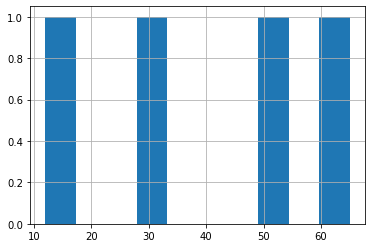

In [137]:
# I've tried to do many different charts, the only one I could manager was the histogram but I don't think it tells me much :( 
# df.groupby('Sex ').plot.bar(y='Age')[labels]
# df2 = df.DataFrame(['Sex '], columns=[labels])
# df2.plot.bar()
# df[df['Sex ']['Age'] == labels].hist()
df['Age'][labels].hist()

# Fatal

In [60]:
# I am not using Injury as it is not relevant for the analysis
df = df.drop(['Injury'], axis = 1)
df

,Year,Type,Country,Sex,Age,Fatal (Y/N),Species
0,2016,Unprovoked,USA,Male,16.0,N,0
1,2016,Unprovoked,AUSTRALIA,Female,60.0,Y,3+ m shark
2,2016,Unprovoked,USA,Female,46.0,N,0
3,2016,Invalid,USA,Male,NaN,N,0
4,2016,Unprovoked,USA,Male,34.0,N,5' to 6' shark
5,2016,Invalid,CAPE VERDE,Male,60.0,N,Shark involvement not confirmed
6,2016,Unprovoked,NEW CALEDONIA,Female,69.0,Y,"Tiger shark, 2.5 m"
7,2016,Unprovoked,USA,Male,26.0,N,"Bull shark, 7'"
8,2016,Provoked,FRENCH POLYNESIA,Male,26.0,N,"Grey reef shark, 2 m"
9,2016,Unprovoked,AUSTRALIA,Male,12.0,N,Wobbegong shark


In [61]:
df['Fatal (Y/N)'].value_counts()

N          4026
Y          1202
UNKNOWN      76
0             9
 N            8
F             1
N             1
Name: Fatal (Y/N), dtype: int64

In [62]:
# Now I'm able to try to replace with the mapping formula instead of going one by one
df['Fatal (Y/N)'] = df['Fatal (Y/N)'].map({' N':'No', 'N': 'No', 'Y': 'Yes', '0':'Unknown','F': 'Yes' })
df['Fatal (Y/N)'].value_counts()

No     4034
Yes    1203
Name: Fatal (Y/N), dtype: int64

<AxesSubplot:ylabel='Year'>

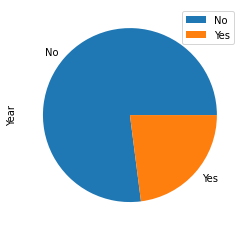

In [82]:
df.groupby('Fatal (Y/N)').count().plot.pie(y='Year')

# Species

In [64]:
df['Species '].value_counts()

0                                                                                                                                                                                                       2389
White shark                                                                                                                                                                                              154
Shark involvement not confirmed                                                                                                                                                                           78
Tiger shark                                                                                                                                                                                               64
Bull shark                                                                                                                                                                          

In [66]:
# Replacing NaN with "Unknown"
df['Species '].fillna("Unknown",inplace = True)

In [74]:
# Deleting empty spaces at the beginning and at the end
df['Species '] = df['Species '].apply(lambda x: str(x).strip())

In [69]:
# Replacing values that seems duplicated or not relevant
df['Species '] = df['Species '].str.replace('"','').str.replace(".*(White).*","White Shark").str.replace(".*(Involvement).*","No Shark Involved")
df['Species '] = df['Species '].str.replace(".*(Bull).*","Bull Shark").str.replace(".*(Tiger).*","Tiger Shark").str.replace(".*(Ragged).*","Ragged Tooth Shark").str.replace(".*(Hammer).*","Hammer Head Shark")
df['Species '] = df['Species '].str.replace(".*(Black).*","Blacktip").str.replace(".*(Mako).*","Mako Shark").str.replace(".*(Lemon).*","Lemon Shark").str.replace(".*(Nurse).*","Nurse Shark").str.replace(".*(Small).*","Small Shark").str.replace(".*(Questionable).*","Questionable Incident").str.replace(".*(Wobbegong).*","Wobbegong Shark").str.replace(".*(Bronze).*","Bronze Whaler Shark").str.replace(".*(Blue).*","Blue")

<ipython-input-69-bcd352212155>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  df['Species '] = df['Species '].str.replace('"','').str.replace(".*(White).*","White Shark").str.replace(".*(Involvement).*","No Shark Involved")
<ipython-input-69-bcd352212155>:3: FutureWarning: The default value of regex will change from True to False in a future version.
  df['Species '] = df['Species '].str.replace(".*(Bull).*","Bull Shark").str.replace(".*(Tiger).*","Tiger Shark").str.replace(".*(Ragged).*","Ragged Tooth Shark").str.replace(".*(Hammer).*","Hammer Head Shark")
<ipython-input-69-bcd352212155>:4: FutureWarning: The default value of regex will change from True to False in a future version.
  df['Species '] = df['Species '].str.replace(".*(Black).*","Blacktip").str.replace(".*(Mako).*","Mako Shark").str.replace(".*(Lemon).*","Lemon Shark").str.replace(".*(Nurse).*","Nurse Shark").str.replace(".*(Small).*","Small Shark").str.replace(".*(Ques

In [77]:
df['Species '] = df['Species '].str.replace(".*[0-200].*","Unknown",regex=True)

In [78]:
# Checking how it looks like now
df['Species '].value_counts()

nan                                                                                                                                                                                                               2389
White Shark                                                                                                                                                                                                        403
Tiger Shark                                                                                                                                                                                                        226
Bull Shark                                                                                                                                                                                                         117
Shark involvement not confirmed                                                                                                             

In [ ]:
# Missing finishing Species data to identify which are the mos fatal ones

# Creating a clean file

In [104]:
df2 = df.copy()

In [105]:
df2.columns

Index(['Year', 'Type', 'Country', 'Sex ', 'Age', 'Fatal (Y/N)', 'Species '], dtype='object')

In [106]:
df2.columns = ['Year', 'Type', 'Country', 'Sex', 'Age', 'Fatal', 'Species']

In [107]:
df2.head()

,Year,Type,Country,Sex,Age,Fatal,Species
0,2016,Unprovoked,USA,Male,16.0,No,nan
1,2016,Unprovoked,AUSTRALIA,Female,60.0,Yes,3+ m shark
2,2016,Unprovoked,USA,Female,46.0,No,nan
3,2016,Invalid,USA,Male,NaN,No,nan
4,2016,Unprovoked,USA,Male,34.0,No,5' to 6' shark


In [138]:
df2.to_csv("sharks_clean.csv", index = False)